# BTC/USDT Orderbook EDA

I analysed BTC/USDT Binance limit and markert orders data from **23.06.22**

Ploted orders distributions, calculated stats and analysed market impact from market orders

In [418]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (15,10)
%matplotlib inline

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import seaborn as sns

In [419]:
df_trades = pd.read_csv('btcusdt:Binance:LinearPerpetual/trades.csv')
df_lobs = pd.read_csv('btcusdt:Binance:LinearPerpetual/lobs.csv')

### Trades data processing

In [420]:
df_trades

,receive_ts,exchange_ts,aggro_side,price,size
0,1655942402624789714,1655942402623000000,BID,19977.5,0.001
1,1655942405293556247,1655942405292000000,BID,19977.5,0.041
2,1655942405293628020,1655942405292000000,BID,19977.5,0.036
3,1655942405293832021,1655942405292000000,BID,19977.5,0.001
4,1655942405293929517,1655942405292000000,BID,19977.5,0.001
...,...,...,...,...,...
5727709,1656028781074283766,1656028781073000000,BID,21089.1,0.001
5727710,1656028781105532654,1656028781104000000,ASK,21089.0,0.059
5727711,1656028781335919353,1656028781335000000,ASK,21089.0,0.137
5727712,1656028781343654663,1656028781342000000,BID,21089.1,0.030


In [421]:
# convert timestamp to datetime
df_trades['receive_ts'] = pd.to_datetime(df_trades['receive_ts'])
df_trades['exchange_ts'] = pd.to_datetime(df_trades['exchange_ts'])

* Amounts of unique timestamps - **more than one trade at one time executed**

In [6]:
len(df_trades['exchange_ts'].unique()), len(df_trades['receive_ts'].unique())

(2093600, 5727714)

We should analyse `exchange_ts` as it is time when market order executed on exchange

In [423]:
ts_per_comming_signal = df_trades.groupby('exchange_ts')['exchange_ts'].count()

ts_per_comming_signal.describe()

count    2.093600e+06
mean     2.735821e+00
std      5.012275e+00
min      1.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      1.460000e+02
Name: exchange_ts, dtype: float64

* On **Avg 2.7** trades per signal with **Median 1.0**

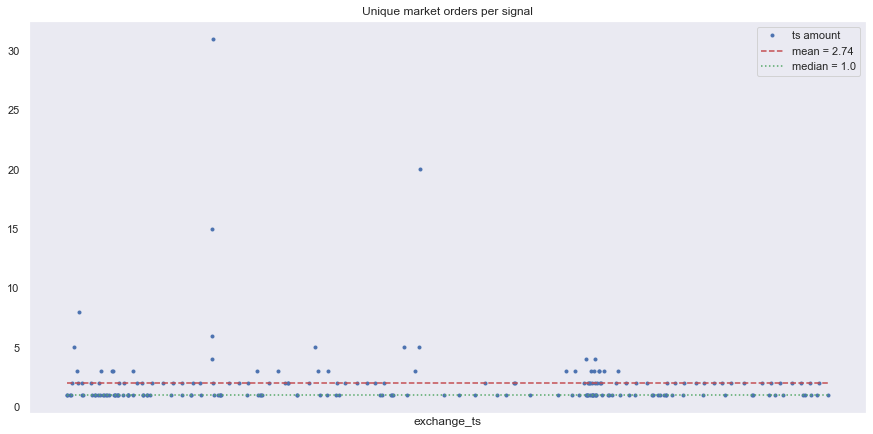

In [447]:
# First 400 signals and ts amounts at those moments
ts_demo = ts_per_comming_signal[400:600]

plt.title('Unique market orders per signal')
ts_demo.plot(figsize=(15,8), label='ts amount', style='.')
plt.hlines([ts_demo.mean()], xmin= ts_demo.index[0], xmax= ts_demo.index[-1], colors=['r'], label='mean = ' + str(round(ts_per_comming_signal.mean(), 2)),linestyles='dashed')
plt.hlines([ts_demo.quantile(0.5)], xmin= ts_demo.index[0], xmax=ts_demo.index[-1], colors=['g'], label='median = '+str(ts_per_comming_signal.median()),linestyles=':')

plt.legend()
plt.show()

* A lot of unique market orders comes in **one timestamp**

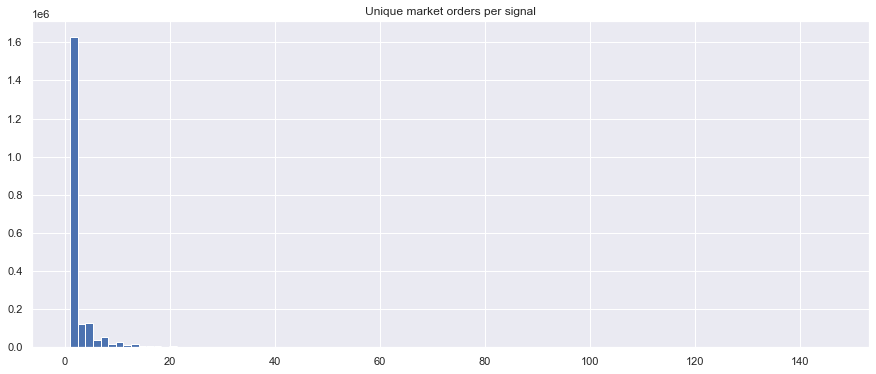

In [252]:
ts_per_comming_signal.hist(figsize=(15,6), bins=100)
plt.title('Unique market orders per signal')
plt.show()

### Orderbook data processing

In [450]:
# From timestamp to dateime
df_lobs['receive_ts'] = pd.to_datetime(df_lobs['receive_ts'])
df_lobs[' exchange_ts'] = pd.to_datetime(df_lobs[' exchange_ts'])

In [449]:
df_lobs

,receive_ts,exchange_ts,btcusdt:Binance:LinearPerpetual_ask_price_0,btcusdt:Binance:LinearPerpetual_ask_vol_0,btcusdt:Binance:LinearPerpetual_bid_price_0,btcusdt:Binance:LinearPerpetual_bid_vol_0,btcusdt:Binance:LinearPerpetual_ask_price_1,btcusdt:Binance:LinearPerpetual_ask_vol_1,btcusdt:Binance:LinearPerpetual_bid_price_1,btcusdt:Binance:LinearPerpetual_bid_vol_1,...,btcusdt:Binance:LinearPerpetual_bid_price_7,btcusdt:Binance:LinearPerpetual_bid_vol_7,btcusdt:Binance:LinearPerpetual_ask_price_8,btcusdt:Binance:LinearPerpetual_ask_vol_8,btcusdt:Binance:LinearPerpetual_bid_price_8,btcusdt:Binance:LinearPerpetual_bid_vol_8,btcusdt:Binance:LinearPerpetual_ask_price_9,btcusdt:Binance:LinearPerpetual_ask_vol_9,btcusdt:Binance:LinearPerpetual_bid_price_9,btcusdt:Binance:LinearPerpetual_bid_vol_9
0,2022-06-23 00:00:02.250125991,2022-06-23 00:00:02.249,19977.5,0.079,19977.4,12.381,19977.8,0.003,19976.7,0.066,...,19975.7,4.455,19980.1,0.01,19975.6,1.529,19980.2,0.010,19975.4,1.641
1,2022-06-23 00:00:02.657844605,2022-06-23 00:00:02.655,19977.5,0.078,19977.4,12.381,19977.8,0.003,19977.3,0.126,...,19975.9,0.246,19980.1,0.01,19975.8,0.686,19980.2,0.010,19975.7,4.455
2,2022-06-23 00:00:03.346968722,2022-06-23 00:00:03.346,19977.5,0.079,19977.4,12.381,19977.8,0.003,19977.3,0.126,...,19975.9,0.246,19980.1,0.01,19975.8,0.686,19980.2,0.010,19975.7,4.455
3,2022-06-23 00:00:04.080791047,2022-06-23 00:00:04.080,19977.5,0.079,19977.4,12.381,19977.8,0.003,19977.3,0.126,...,19975.9,0.246,19980.1,0.01,19975.8,0.686,19980.2,0.010,19975.7,4.455
4,2022-06-23 00:00:04.452706766,2022-06-23 00:00:04.452,19977.5,0.079,19977.4,12.381,19977.8,0.003,19977.3,0.126,...,19975.9,0.246,19980.1,0.01,19975.8,0.686,19980.2,0.010,19975.7,4.455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2541351,2022-06-23 23:59:41.390653694,2022-06-23 23:59:41.390,21089.1,0.730,21089.0,7.845,21089.3,0.001,21088.9,2.800,...,21087.4,0.024,21092.5,0.55,21087.1,0.232,21092.6,0.001,21087.0,2.484
2541352,2022-06-23 23:59:41.423672729,2022-06-23 23:59:41.423,21089.1,0.730,21089.0,7.845,21089.3,0.001,21088.9,2.800,...,21087.4,0.024,21092.4,0.83,21087.1,0.232,21092.5,0.550,21087.0,2.484
2541353,2022-06-23 23:59:41.457683317,2022-06-23 23:59:41.457,21089.1,0.736,21089.0,7.845,21089.3,0.001,21088.9,2.800,...,21087.4,0.024,21092.4,0.83,21087.1,0.232,21092.5,0.550,21087.0,2.484
2541354,2022-06-23 23:59:41.492806433,2022-06-23 23:59:41.492,21089.1,0.736,21089.0,7.845,21089.3,0.001,21088.9,2.800,...,21087.4,0.024,21092.4,0.83,21087.1,0.232,21092.5,0.550,21087.0,2.484


* Transform level prices and volumes to convinient format to get `df_volumes` and `df_prices`

In [454]:
df_lobs_t = df_lobs.drop([' exchange_ts', 'receive_ts'], axis=1)

In [455]:
df_lobs_t.columns = np.arange(0,40)

In [456]:
# Ask already followed natural order
df_ask_prices = df_lobs_t.loc[:, range(0,40,4)]
df_ask_volumes = df_lobs_t.loc[:, range(1,40,4)]

# Bid follows reversed natural order
df_bid_prices = df_lobs_t.loc[:, range(2,40,4)]
df_bid_volumes = df_lobs_t.loc[:, range(3,40,4)]

# Reverse Bid price and volumnes to make them follow natural order
df_bid_prices = df_bid_prices[df_bid_prices.columns[::-1]]
df_bid_volumes = df_bid_volumes[df_bid_volumes.columns[::-1]]

# Concatenate Bid and Ask together to form complete orderbook picture
df_prices = df_bid_prices.join(df_ask_prices, how='outer')
df_volumnes = df_bid_volumes.join(df_ask_volumes, how='outer')

#Rename columns starting from 1->20
df_prices.columns = range(1, 21)
df_volumnes.columns = range(1, 21)

df_prices.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
0,19975.4,19975.6,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19977.4,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
1,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,19977.4,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
2,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,19977.4,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
3,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,19977.4,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
4,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,19977.4,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2


In [457]:
df_volumnes.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
0,1.641,1.529,4.455,0.686,0.246,0.205,0.146,0.050,0.066,12.381,0.079,0.003,0.003,1.283,0.001,0.612,0.216,1.117,0.01,0.01
1,4.455,0.686,0.246,0.205,0.146,0.050,0.066,1.057,0.126,12.381,0.078,0.003,0.003,1.283,0.001,0.612,0.216,1.117,0.01,0.01
2,4.455,0.686,0.246,0.205,0.146,0.050,0.066,1.057,0.126,12.381,0.079,0.003,0.003,1.283,0.001,0.612,0.216,1.117,0.01,0.01
3,4.455,0.686,0.246,0.205,0.146,0.050,0.066,1.057,0.126,12.381,0.079,0.003,0.003,1.283,0.001,0.612,0.216,1.117,0.01,0.01
4,4.455,0.686,0.246,0.205,0.146,0.050,0.066,1.057,0.126,12.381,0.079,0.003,0.003,1.283,0.001,0.612,0.216,1.117,0.01,0.01


1) Построить графики, как ведут себя best уровни стаканов (файл lobs) и price проведённых сделок (файл trades) во времени.

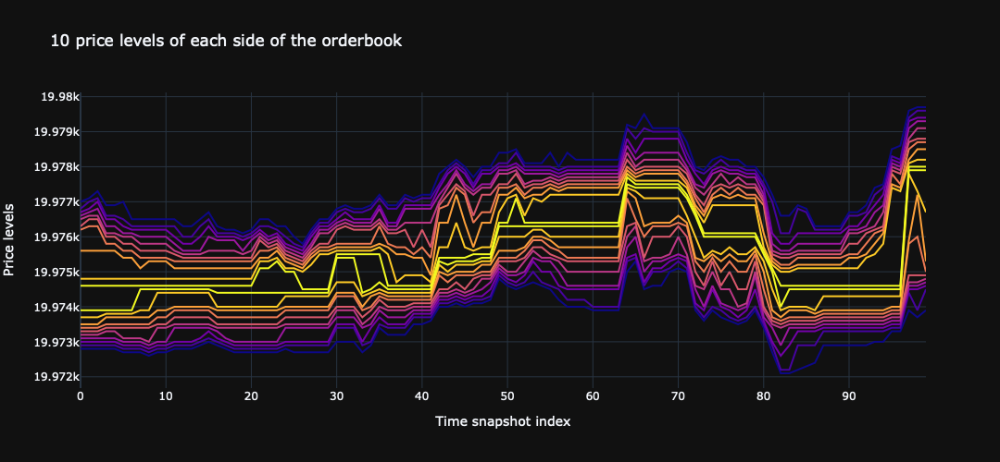

In [461]:
# Orderbook levels movement

fig = go.Figure()


for i in df_prices.columns:
# for i in range(1,2): 
    fig.add_trace(go.Scatter(y=df_prices[300:400][i], marker_color=px.colors.sequential.Plasma_r[np.abs(int(i-10.5))]))

fig.update_layout(
    title='10 price levels of each side of the orderbook',
    xaxis_title="Time snapshot index",
    yaxis_title="Price levels",
    template='plotly_dark',
    height=500,
    showlegend=False,
)

fig.show()

In [462]:
# Colors for orderbook histograms
colors = ['green',] * 10
colors = colors + ['crimson',] * 10

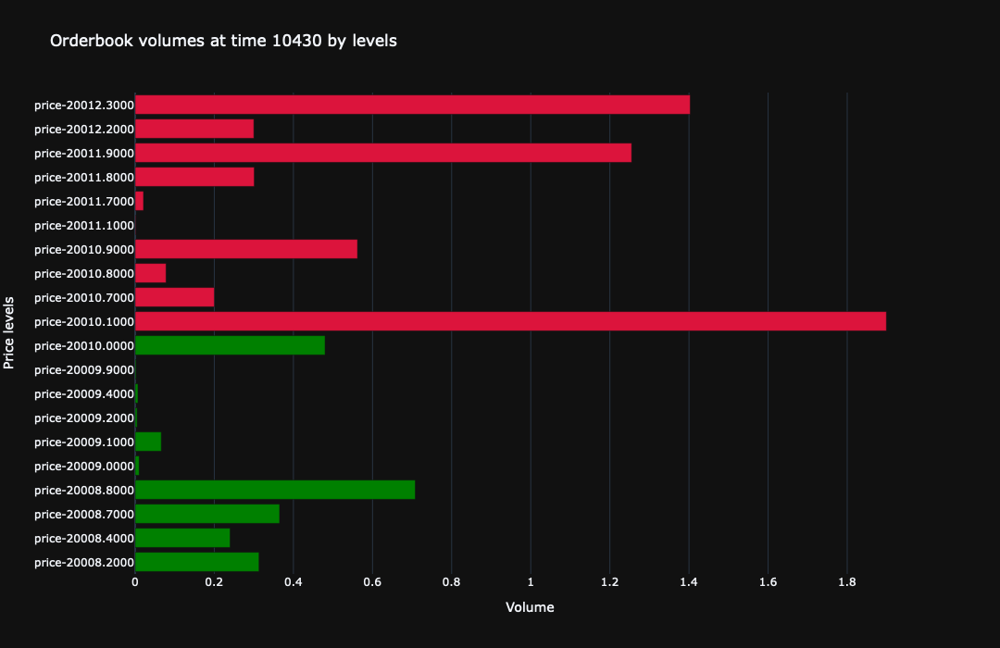

In [463]:
# Orderbook distribution

fig = go.Figure()
timestamp = 10430

fig.add_trace(go.Bar(
    y= ['price-'+'{:.4f}'.format(x) for x in df_prices.values[timestamp].tolist()],
    x=df_volumnes.values[timestamp].tolist(),
    orientation='h',
    marker_color=colors
))

fig.update_layout(
    width=1000,
    height=700,
    title='Orderbook volumes at time ' + str(timestamp) + ' by levels',
    xaxis_title="Volume",
    yaxis_title="Price levels",
    template='plotly_dark'
)

fig.show()

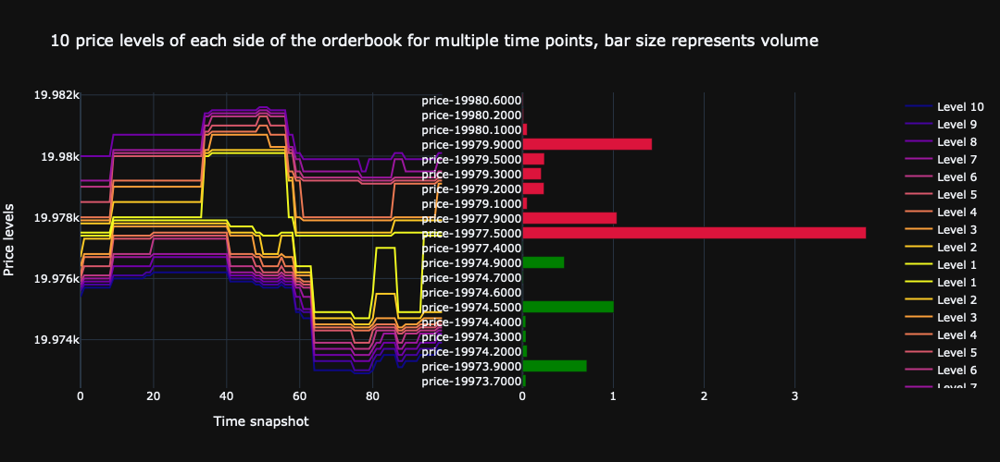

In [464]:
# orderbook levels along with histograms
fig = make_subplots(rows=1, cols=2)

for i in df_prices.columns[:-2]: 
    fig.add_trace(go.Scatter(y=df_prices.head(100)[i], marker_color = px.colors.sequential.Plasma_r[np.abs(int(int(i)-10.5))], name = "Level " + str(np.abs(int(int(i) - 10.5)) + 1)), row=1, col=1)

timestamp = 100

fig.add_trace(go.Bar(
    y= ['price-'+'{:.4f}'.format(x) for x in df_prices.values[timestamp].tolist()],
    x=df_volumnes.values[timestamp].tolist(),
    orientation='h',
    marker_color=colors
), row=1, col=2)

fig.update_layout(
    width=1000,
    height=500,
    title='10 price levels of each side of the orderbook for multiple time points, bar size represents volume',
    xaxis_title="Time snapshot",
    yaxis_title="Price levels",
    template='plotly_dark'
)

fig.show()

### Live orderbook - press **Run** to start 

In [467]:
# Live Orderbook from 100 to 500 timestamps
def live_orderbook(df_volumnes, df_prices, timeStampStart):

    fig = go.Figure(
        data=[go.Bar(y= ['price-'+'{:.4f}'.format(x) for x in df_prices[:timeStampStart].values[0].tolist()],
                     x=df_volumnes[:timeStampStart].values[0].tolist(),
                     orientation='h',
                     name="priceBar",
                     marker_color=colors),
              ],
        layout=go.Layout(width=800, height=450,
                         title="Live orderbook volumes",
                         xaxis_title="Volume",
                         yaxis_title="Price levels",
                         template='plotly_dark',
                         hovermode="closest",
                         updatemenus=[dict(type="buttons",
                                           showactive=True,
                                           x=0.01,
                                           xanchor="left",
                                           y=1.15,
                                           yanchor="top",
                                           font={"color":'blue'},
                                           buttons=[dict(label="Run",
                                                         method="animate",
                                                         args=[None])])]),
        frames=[go.Frame(
            data=[go.Bar(y= ['price-'+'{:.4f}'.format(x) for x in df_prices.iloc[k].values.tolist()],
                         x=df_volumnes.iloc[k].values.tolist(),
                         orientation='h',
                         marker_color=colors)],
            layout=go.Layout(width=800, height=450,
                         title="Live orderbook volumes [Snapshot=" + str(k) +"]",
                         xaxis_title="Volume",
                         yaxis_title="Price levels",
                         template='plotly_dark',
                         hovermode="closest")) for k in range(timeStampStart, 500)]
    )

    fig.show()

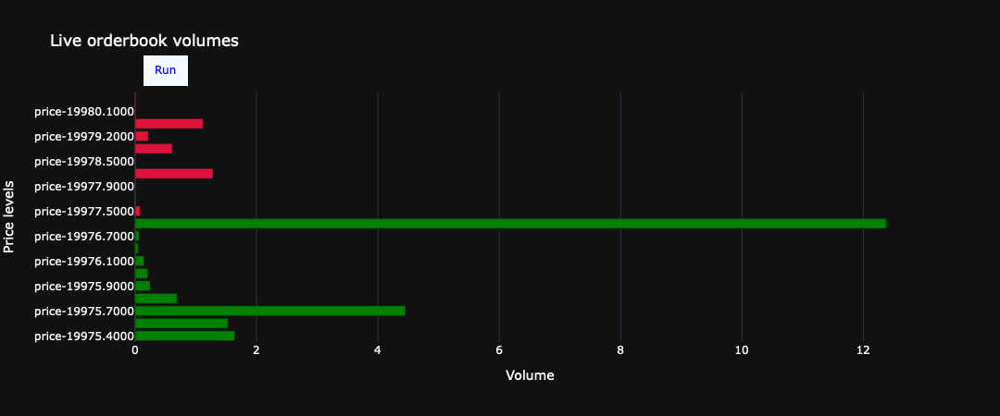

In [468]:
live_orderbook(df_volumnes, df_prices, 100)

### Remove Outliers

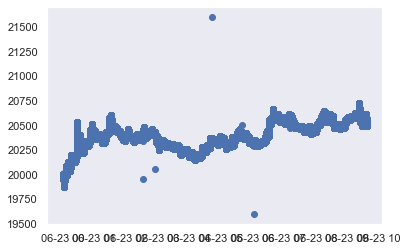

In [470]:
plt.scatter(x=df_trades.loc[0:2000000]['exchange_ts'], y= df_trades.loc[0:2000000]['price'])
plt.show()

* We clearly can see outliers - probably some data errors

### Fill lobs to match trades

Need to merge 2 dataframes

In [475]:
len(df_trades['receive_ts'].unique())

5727714

In [474]:
len(df_lobs['receive_ts'].unique())

2541356

In [479]:
# Add timestamp to prices df's
df_prices['receive_ts'] = df_lobs['receive_ts']
df_prices['exchange_ts'] = df_lobs[' exchange_ts']

* Extend dataframe with orderbook by `receive_ts` - so all trades timestamps covered

In [480]:
df_merged = df_trades.merge(df_prices, on='receive_ts', how='outer').sort_values('receive_ts')
df_merged = df_merged.drop(['exchange_ts_x', 'exchange_ts_y', 'aggro_side', 'price', 'size'], axis=1)
df_merged = df_merged.fillna(method='ffill')

In [483]:
df_merged.head(10)

,receive_ts,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
5727714,2022-06-23 00:00:02.250125991,19975.4,19975.6,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
0,2022-06-23 00:00:02.624789714,19975.4,19975.6,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727715,2022-06-23 00:00:02.657844605,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727716,2022-06-23 00:00:03.346968722,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727717,2022-06-23 00:00:04.080791047,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727718,2022-06-23 00:00:04.452706766,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727719,2022-06-23 00:00:04.488775046,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727720,2022-06-23 00:00:04.752033322,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727721,2022-06-23 00:00:05.044733617,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
5727722,2022-06-23 00:00:05.249754884,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2


In [484]:
df_merged = df_merged.reset_index(drop=True)

### Plot on recieve time

Short interval on recieve time - definetly not right as we shoud match by exchange time

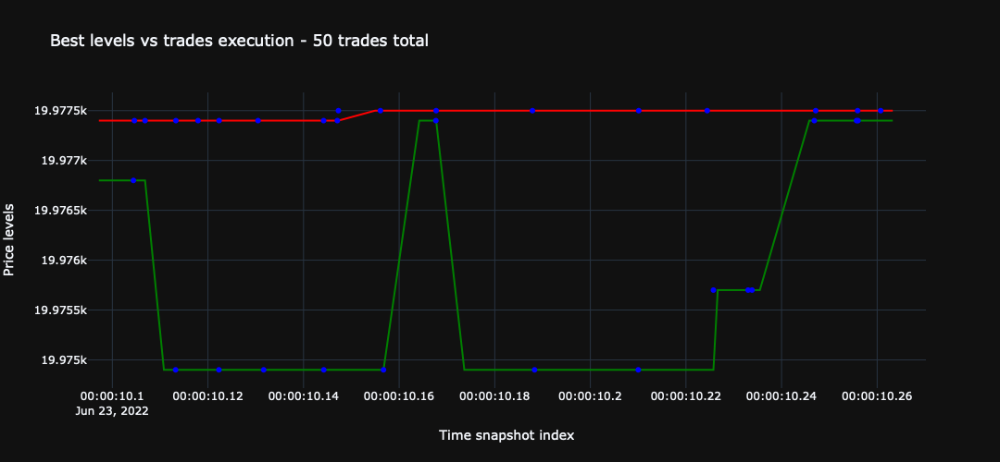

In [488]:
fig = go.Figure()

start = 400
finish = 450

fig.add_trace(go.Scatter(x=df_merged[start:finish]['receive_ts'],y=df_merged[start:finish][10], marker_color='green'))
fig.add_trace(go.Scatter(x=df_merged[start:finish]['receive_ts'],y=df_merged[start:finish][11], marker_color='red'))
y = df_trades[(df_merged['receive_ts'][start] < df_trades['receive_ts']) & (df_trades['receive_ts'] < df_merged['receive_ts'][finish])]['price']
x = df_trades[(df_merged['receive_ts'][start] < df_trades['receive_ts']) & (df_trades['receive_ts'] < df_merged['receive_ts'][finish])]['receive_ts']
fig.add_trace(go.Scatter(x=x,y=y, marker_color='blue', mode='markers'))

fig.update_layout(
    title='Best levels vs trades execution - 50 trades total',
    xaxis_title="Time snapshot index",
    yaxis_title="Price levels",
    template='plotly_dark',
    height=500,
    showlegend=False,
)

fig.show()

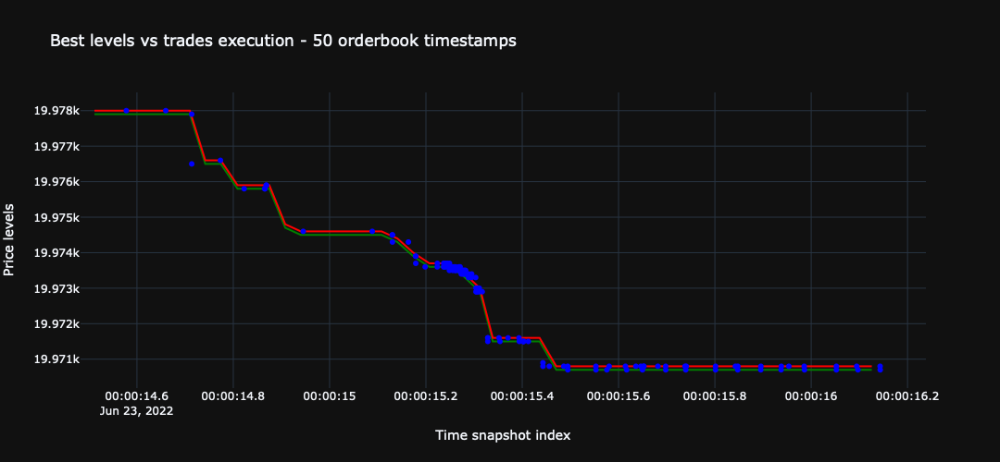

In [489]:
fig = go.Figure()

start = 400
finish = 450

fig.add_trace(go.Scatter(x=df_prices[start:finish]['receive_ts'],y=df_prices[start:finish][10], marker_color='green'))
fig.add_trace(go.Scatter(x=df_prices[start:finish]['receive_ts'],y=df_prices[start:finish][11], marker_color='red'))
y = df_trades[(df_prices['receive_ts'][start] < df_trades['receive_ts']) & (df_trades['receive_ts'] < df_prices['receive_ts'][finish])]['price']
x = df_trades[(df_prices['receive_ts'][start] < df_trades['receive_ts']) & (df_trades['receive_ts'] < df_prices['receive_ts'][finish])]['receive_ts']
fig.add_trace(go.Scatter(x=x,y=y, marker_color='blue', mode='markers'))

fig.update_layout(
    title='Best levels vs trades execution - 50 orderbook timestamps',
    xaxis_title="Time snapshot index",
    yaxis_title="Price levels",
    template='plotly_dark',
    height=500,
    showlegend=False,
)

fig.show()

### We should plot on exchange_ts time - as it's time of exchange execution

* Now let's match on exchange_ts

In [490]:
df_prices_m = df_trades.merge(df_prices, on='exchange_ts', how='outer').sort_values('exchange_ts')
df_prices_m = df_prices_m.drop(['receive_ts_x', 'receive_ts_y', 'aggro_side', 'price', 'size'], axis=1)
df_prices_m = df_prices_m.fillna(method='ffill')
df_prices_m = df_prices_m.reset_index(drop=True)

In [491]:
df_prices_m.head(5)

,exchange_ts,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,2022-06-23 00:00:02.249,19975.4,19975.6,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
1,2022-06-23 00:00:02.623,19975.4,19975.6,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
2,2022-06-23 00:00:02.655,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
3,2022-06-23 00:00:03.346,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
4,2022-06-23 00:00:04.080,19975.7,19975.8,19975.9,19976.0,19976.1,19976.4,19976.7,19976.8,19977.3,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2


In [497]:
# Function to plot best BID, ASK along with market orders executed on both sides  

def plot_price(start, finish, df_prices_m, df_trades):
    fig = go.Figure()


    fig.add_trace(go.Scatter(x=df_prices_m[start:finish]['exchange_ts'],y=df_prices_m[start:finish][11], marker_color='red', mode='lines', name='best ASK'))
    df_trades_sample = df_trades[(df_prices_m['exchange_ts'][start] < df_trades['exchange_ts']) & (df_trades['exchange_ts'] < df_prices_m['exchange_ts'][finish])]
    fig.add_trace(go.Scatter(x=df_trades_sample[df_trades_sample['aggro_side']=='BID']['exchange_ts'],y=df_trades_sample[df_trades_sample['aggro_side']=='BID']['price'], marker_color='red', mode='markers', name='ASK executed'))
    fig.add_trace(go.Scatter(x=df_trades_sample[df_trades_sample['aggro_side']=='ASK']['exchange_ts'],y=df_trades_sample[df_trades_sample['aggro_side']=='ASK']['price'], marker_color='green', mode='markers', name='BID executed'))
    fig.add_trace(go.Scatter(x=df_prices_m[start:finish]['exchange_ts'],y=df_prices_m[start:finish][10], marker_color='green', mode='lines', name='best BID'))

    # Let's add moving averages
    fig.add_trace(go.Scatter(x=df_trades_sample['exchange_ts'],y=df_trades_sample['price'].rolling(10).mean().fillna(method='bfill'), marker_color='blue', name='Moving Avg - 10'))
    #fig.add_trace(go.Scatter(x=df_trades_sample['exchange_ts'],y=df_trades_sample['price'].rolling(30).mean().fillna(method='bfill'), marker_color='yellow', name='Moving Avg - 30'))


    fig.update_layout(
        title='Best levels vs trades execution',
        xaxis_title="Time snapshot index",
        yaxis_title="Price levels",
        template='plotly_dark',
        height=500,
        showlegend=True,
    )

    fig.show()

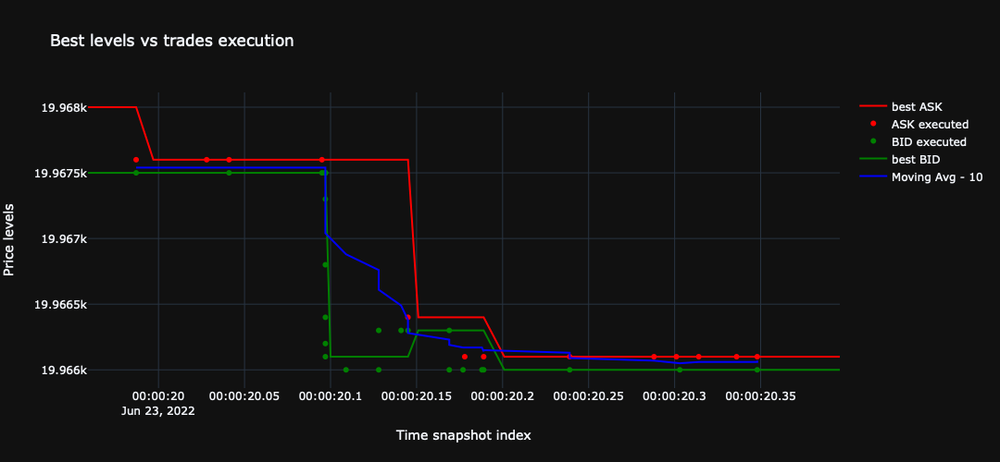

In [498]:
start = 2000
finish = 2050

plot_price(start, finish, df_prices_m, df_trades)

#### Why dot's leave best Line? - probably too many transactions before another message from exchange about orderbook

* Green dots below best BID and Red dots above best ASK is orderbook impact

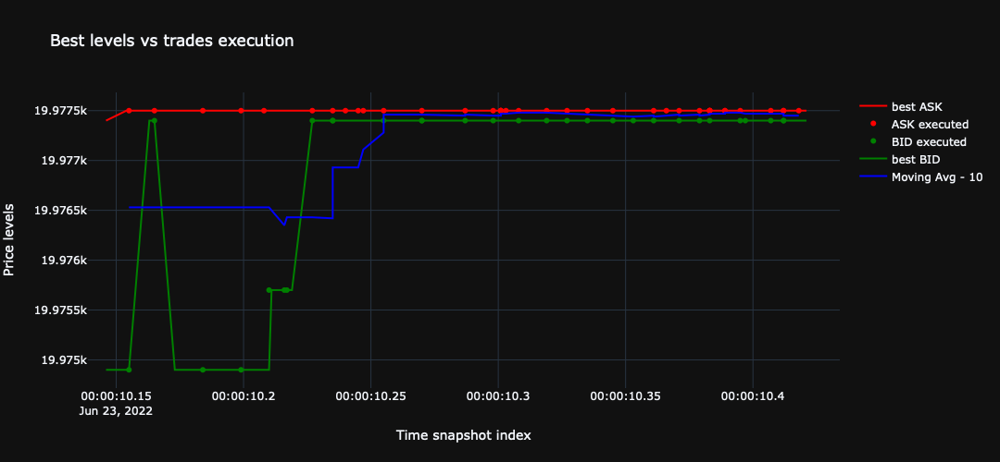

In [499]:
start = 400
finish = 500

plot_price(start, finish, df_prices_m, df_trades)


#### Let's find stats for best BID / ASK volumes

In [500]:
df_volumnes[[10, 11]].describe()

,10,11
count,2.541356e+06,2.541356e+06
mean,2.682905e+00,2.561160e+00
std,5.588091e+00,4.282262e+00
min,1.000000e-03,1.000000e-03
25%,3.400000e-01,3.470000e-01
50%,1.377000e+00,1.358000e+00
75%,3.525000e+00,3.377000e+00
max,9.059300e+02,4.341380e+02


* On average **2.68** BTC per BID and **2.56** per ASK.



#### Volumes stats

In [501]:
df_trades['size'].describe()

count    5.727714e+06
mean     1.220080e-01
std      5.596711e-01
min      1.000000e-03
25%      2.000000e-03
50%      1.700000e-02
75%      9.700000e-02
max      2.357930e+02
Name: size, dtype: float64

On average **.122** BTC volume per trade, **.170** is median

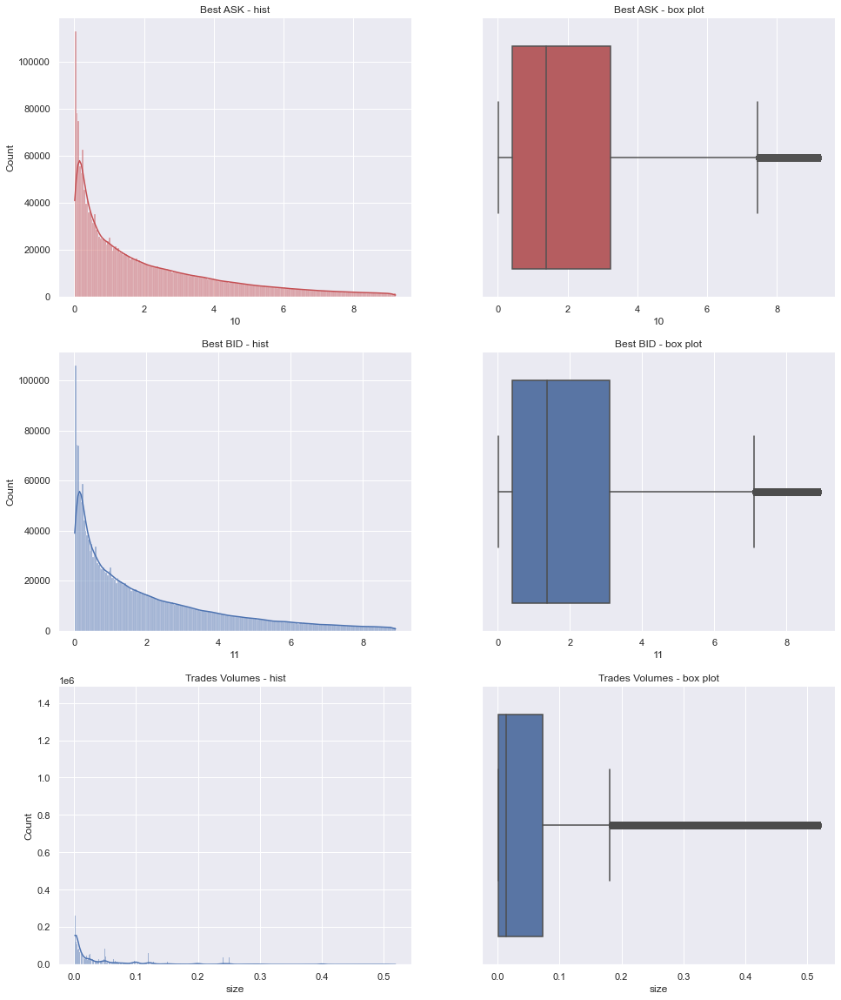

In [503]:
# Hists and boxpots of ASK/BID and trades volumes 

sns.set()
fig, axes = plt.subplots(3, 2)

sns.set(
    rc={'figure.figsize':(16,20)}, 
    style="dark"
)

sns.histplot(df_volumnes[10][df_volumnes[10].between(df_volumnes[10].quantile(.05), df_volumnes[10].quantile(.95))],label = 'ASK volumes',kde=True, color='r', ax=axes[0,0], legend=True)
sns.boxplot(x=df_volumnes[10][df_volumnes[10].between(df_volumnes[10].quantile(.05), df_volumnes[10].quantile(.95))], color='r', ax=axes[0,1])
axes[0,0].set_title('Best ASK - hist')
axes[0,1].set_title('Best ASK - box plot')
sns.histplot(df_volumnes[11][df_volumnes[11].between(df_volumnes[11].quantile(.05), df_volumnes[11].quantile(.95))],label = 'ASK volumes',kde=True, color='b', ax=axes[1,0], legend=True)
sns.boxplot(x=df_volumnes[11][df_volumnes[11].between(df_volumnes[11].quantile(.05), df_volumnes[11].quantile(.95))], color='b', ax=axes[1,1])
axes[1,0].set_title('Best BID - hist')
axes[1,1].set_title('Best BID - box plot')
sns.histplot(df_trades['size'][df_trades['size'].between(df_trades['size'].quantile(.05), df_trades['size'].quantile(.95))],label = 'ASK volumes',kde=True, color='b', ax=axes[2,0], legend=True)
sns.boxplot(x=df_trades['size'][df_trades['size'].between(df_trades['size'].quantile(.05), df_trades['size'].quantile(.95))], color='b', ax=axes[2,1])
axes[2,0].set_title('Trades Volumes - hist')
axes[2,1].set_title('Trades Volumes - box plot')

sns.despine()

* Looks like **exponential distr** with long tails 

### Live cumulative orderbook - press run

In [272]:
df_volumnes_cum = df_volumnes.copy(True)

df_volumnes_cum.loc[:,11:20] = df_volumnes.loc[:,11:20].cumsum(axis=1)
df_volumnes_cum.loc[:,10:1:-1] = df_volumnes.loc[:,10:1:-1].cumsum(axis=1)

In [504]:
df_volumnes_cum.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
0,21.405,19.764,18.235,13.780,13.094,12.848,12.643,12.497,12.447,12.381,0.079,0.082,0.085,1.368,1.369,1.981,2.197,3.314,3.324,3.334
1,19.418,14.963,14.277,14.031,13.826,13.680,13.630,13.564,12.507,12.381,0.078,0.081,0.084,1.367,1.368,1.980,2.196,3.313,3.323,3.333
2,19.418,14.963,14.277,14.031,13.826,13.680,13.630,13.564,12.507,12.381,0.079,0.082,0.085,1.368,1.369,1.981,2.197,3.314,3.324,3.334
3,19.418,14.963,14.277,14.031,13.826,13.680,13.630,13.564,12.507,12.381,0.079,0.082,0.085,1.368,1.369,1.981,2.197,3.314,3.324,3.334
4,19.418,14.963,14.277,14.031,13.826,13.680,13.630,13.564,12.507,12.381,0.079,0.082,0.085,1.368,1.369,1.981,2.197,3.314,3.324,3.334


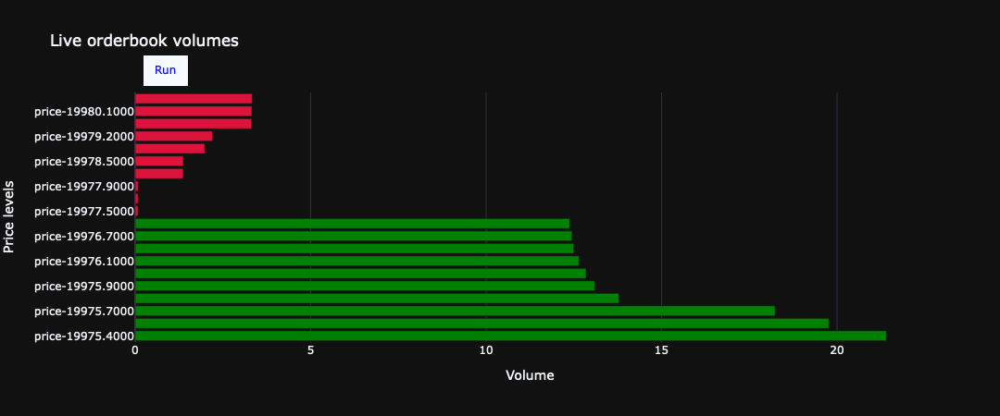

In [505]:
live_orderbook(df_volumnes_cum, df_prices, 100)

## Market Orders Impact Analysis

In [714]:
# Fill columns to concat dataframes
df_trades[np.arange(1,21)] = np.nan
df_prices[['aggro_side', 'price', 'size']] = np.nan

In [715]:
# Concatenate dataframes

df_prices_merged = pd.concat([df_trades, df_prices]).sort_values('exchange_ts')
#df_prices_merged = df_prices_merged.drop(['receive_ts_x', 'receive_ts_y'], axis=1)
#df_prices_merged.loc[0:20] = df_prices_merged.loc[0:20].fillna(method='ffill')
df_prices_merged = df_prices_merged.reset_index(drop=True)

In [716]:
df_prices_merged.head()

,receive_ts,exchange_ts,aggro_side,price,size,1,2,3,4,5,...,11,12,13,14,15,16,17,18,19,20
0,2022-06-23 00:00:02.250125991,2022-06-23 00:00:02.249,NaN,NaN,NaN,19975.4,19975.6,19975.7,19975.8,19975.9,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
1,2022-06-23 00:00:02.624789714,2022-06-23 00:00:02.623,BID,19977.5,0.001,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2022-06-23 00:00:02.657844605,2022-06-23 00:00:02.655,NaN,NaN,NaN,19975.7,19975.8,19975.9,19976.0,19976.1,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
3,2022-06-23 00:00:03.346968722,2022-06-23 00:00:03.346,NaN,NaN,NaN,19975.7,19975.8,19975.9,19976.0,19976.1,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2
4,2022-06-23 00:00:04.080791047,2022-06-23 00:00:04.080,NaN,NaN,NaN,19975.7,19975.8,19975.9,19976.0,19976.1,...,19977.5,19977.8,19977.9,19978.0,19978.5,19979.0,19979.2,19980.0,19980.1,19980.2


In [762]:
# Function to show price impact

def plot_price_impact(start, finish, df, side='ASK', ):
    fig = go.Figure()
    

    df_demo=df[start:finish]

    fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                   vertical_spacing=0.03, subplot_titles=(side + ' Side Orderbook Impact', 'Volumes'), 
                   row_width=[0.2, 0.7])

    fig.add_trace(go.Scatter(y=df_demo[side.lower() + '_impact'], marker_color='green', name=side +' ts impact'), row=1, col=1)


    fig.add_trace(go.Scatter(y=df_demo['size'], showlegend=False,  name=side + ' volume'), row=2, col=1)

    # Do not show OHLC's rangeslider plot 
    #fig.update(layout_xaxis_rangeslider_visible=False)
    #fig.show()

    fig.update_layout(
        title='Price impact by trades',
        xaxis_title="Time snapshot index",
        yaxis_title="Price levels",
        template='plotly_dark',
        height=500,
        showlegend=True,
    )

    fig.show()

#### ASK side orderbook impact

In [718]:
# get rid of BID size levels 

df_m_ask = df_prices_merged[df_prices_merged['aggro_side'] != 'BID'].drop(columns=[11,12,13,14,15,16,17,18,19,20])
df_m_ask = df_m_ask.reset_index(drop=True)

# fill backward best ASK to calcualte pct_change - 1st variant
#df_m_ask[10] = df_m_ask[10].fillna(method='bfill')

# fill best ASK with price to calcualte pct_change - 2nd variant
df_m_ask.loc[df_m_ask['aggro_side']=='ASK', 10] = df_m_ask[df_m_ask['aggro_side']=='ASK']['price']
df_m_ask = df_m_ask.sort_values(['exchange_ts', 10], ascending=[True, False]).reset_index(drop=True)

As trades placed on ASK side affect only 1-10 colums lets plot this chart

In [719]:
# Calcualte pct change

df_m_ask['ask_impact'] = df_m_ask[10].pct_change() * 100

# Leave only trade rows
df_ask = df_m_ask[df_m_ask['aggro_side']=='ASK']
df_ask = df_ask.reset_index(drop=True)

#### As we know **exchange sends updates on orderbook levels with specific frequency**, so

All the `ask_impact` > 0 is moments when:
1. Exchange recieve limit order  -> Bid levels updated -> exchange not sends info yet 
2. Maket order comes to exchange -> It executes on new level recieved in 1 -> exchange sends info to us
2. So it looks like ASK order moved BID but it's not

So therefore we can make `ask_impact` > 0 equal to 0

Look at **235** index above

Also we need to deduct first order `ask_impact` as first one only takes liquidity left in current best level - therefore when first ASK trade after has negative `ask_impact` it's also for reason discussed above

In [720]:
# delete ask_impact > 0

df_ask.loc[df_ask['ask_impact'] > 0,'ask_impact'] = 0

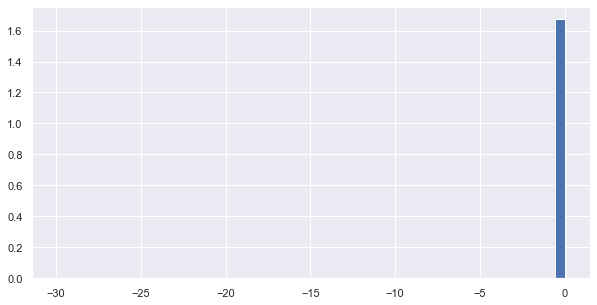

In [721]:
plt.rcParams["figure.figsize"] = (10,5)

df_ask[df_ask['aggro_side']=='ASK']['ask_impact'].hist(bins=50, density=True)
plt.show()

Zero is dominant impact. Let's see distribution of non zero impacts

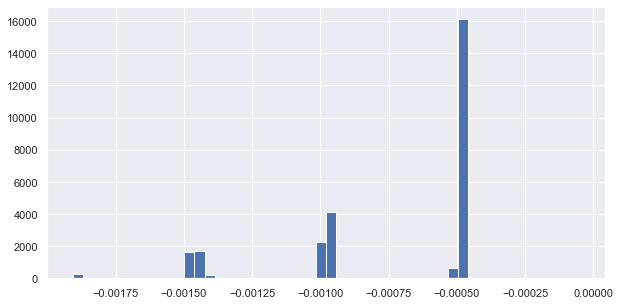

In [722]:
plt.rcParams["figure.figsize"] = (10,5)
df_ask[(df_ask['aggro_side']=='ASK') & (df_ask['ask_impact']!=0) & (df_ask['ask_impact'].between(df_ask['ask_impact'].quantile(.05), df_ask['ask_impact'].quantile(.95)))]['ask_impact'].hist(bins=50, density=True)
plt.show()

Need to aggregate all ASK bids arrived in one timestamp to calculate impact

In [723]:
# Group by timestamps

df_ask_grouped = df_ask.groupby('exchange_ts').agg({
                    'size':'sum',
                    'ask_impact': 'sum'
                    })

In [571]:
df_ask_grouped = df_ask_grouped.fillna(0)

* plots are provided below

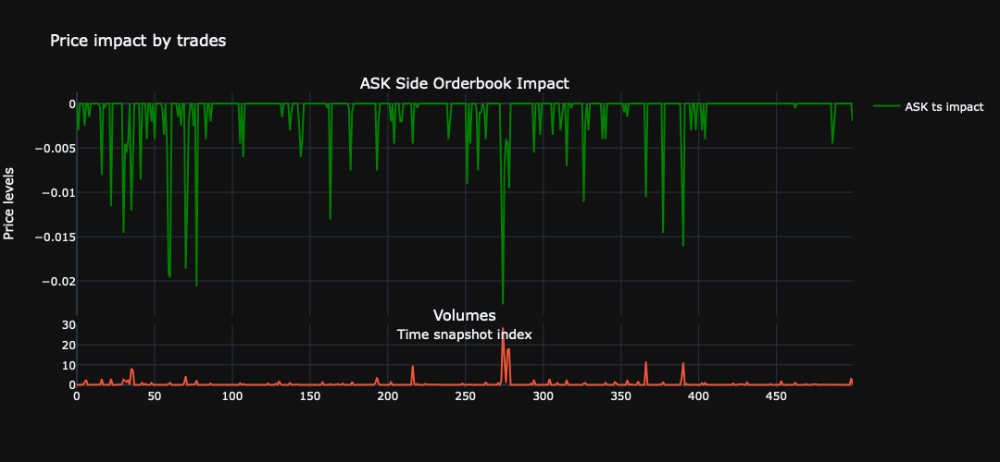

In [763]:
plot_price_impact(4000, 4500, df_ask_grouped, 'ASK')

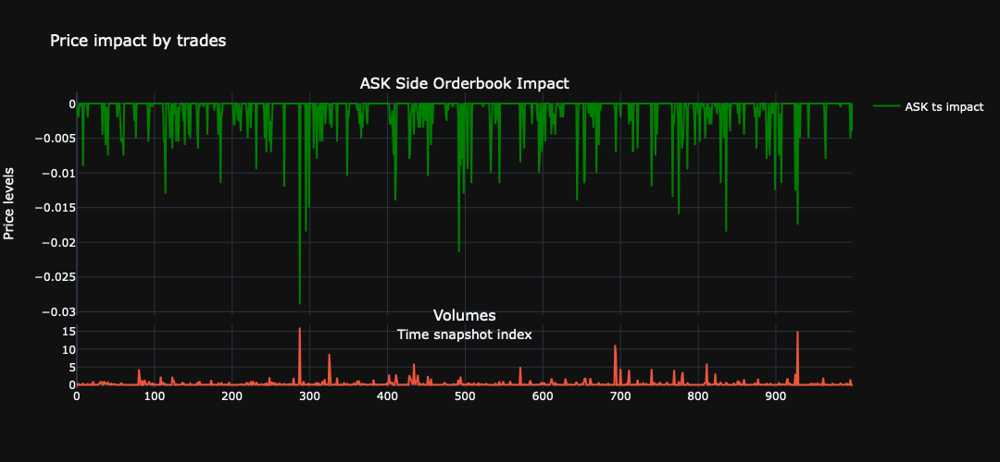

In [769]:
plot_price_impact(10000, 11000, df_ask_grouped, 'ASK')

* **Volumes peaks correspond to impact peaks** 

### BID impact analysis

In [739]:
# get rid of BID size levels 

df_m_bid = df_prices_merged[df_prices_merged['aggro_side'] != 'ASK'].drop(columns=[1,2,3,4,5,6,7,8,9,10])
df_m_bid = df_m_bid.reset_index(drop=True)

# fill backward best BID to calcualte pct_change - 1st variant
#df_m_bid[11] = df_m_bid[11].fillna(method='bfill')

# fill best BID with price to calcualte pct_change - 2nd variant
df_m_bid.loc[df_m_bid['aggro_side']=='BID', 11] = df_m_bid[df_m_bid['aggro_side']=='BID']['price']
df_m_bid = df_m_bid.sort_values(['exchange_ts', 11], ascending=[True, False]).reset_index(drop=True)

As trades placed on BID side affect only 11-20 colums lets plot this chart

In [740]:
# Calcualte pct change

df_m_bid['bid_impact'] = df_m_bid[11].pct_change() * 100

# Leave only trade rows
df_bid = df_m_bid[df_m_bid['aggro_side']=='BID']
df_bid = df_bid.reset_index(drop=True)

#### (Same logic as in ASK analysis)
#### As we know **exchange sends updates on orderbook levels with specific frequency**, so

All the `bid_impact` < 0 is moments when:
1. Exchange recieve limit order  -> ASK levels updated -> exchange not sends info yet 
2. Maket order comes to exchange -> It executes on new level recieved in 1 -> exchange sends info to us
2. So it looks like BID order moved ASK but it's not

So therefore we can make `bid_impact` < 0 equal to 0

Also we need to deduct first order `bid_impact` as first one only takes liquidity left in current best level - therefore when first BID trade after has negative `bid_impact` it's also for reason discussed above

In [743]:
# delete bid_impact < 0

df_bid.loc[df_bid['bid_impact'] < 0,'bid_impact'] = 0

In [745]:
df_bid.head()

,receive_ts,exchange_ts,aggro_side,price,size,11,12,13,14,15,16,17,18,19,20,bid_impact
0,2022-06-23 00:00:02.624789714,2022-06-23 00:00:02.623,BID,19977.5,0.001,19977.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
1,2022-06-23 00:00:05.294206928,2022-06-23 00:00:05.292,BID,19978.0,0.001,19978.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.002503
2,2022-06-23 00:00:05.294140676,2022-06-23 00:00:05.292,BID,19977.9,0.003,19977.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
3,2022-06-23 00:00:05.294003345,2022-06-23 00:00:05.292,BID,19977.8,0.003,19977.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
4,2022-06-23 00:00:05.293628020,2022-06-23 00:00:05.292,BID,19977.5,0.036,19977.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000


In [755]:
#plt.rcParams["figure.figsize"] = (10,5)

#df_bid[df_bid['aggro_side']=='BID']['bid_impact'].hist(bins=50, density=True)
#plt.show()

Zero is dominant impact. Let's see distribution of non zero impacts

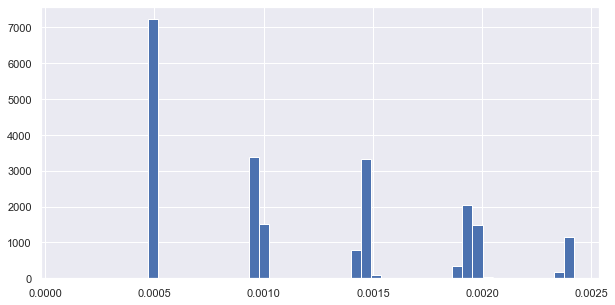

In [757]:
plt.rcParams["figure.figsize"] = (10,5)
df_bid[(df_bid['aggro_side']=='BID') & (df_bid['bid_impact']!=0) & (df_bid['bid_impact'].between(df_bid['bid_impact'].quantile(.05), df_bid['bid_impact'].quantile(.95)))]['bid_impact'].hist(bins=50, density=True)
plt.show()

Need to aggregate all BID bids arrived in one timestamp to calculate impact

In [758]:
# Group by timestamps

df_bid_grouped = df_bid.groupby('exchange_ts').agg({
                    'size':'sum',
                    'bid_impact': 'sum'
                    })

In [571]:
df_bid_grouped = df_bid_grouped.fillna(0)

* plots are provided below

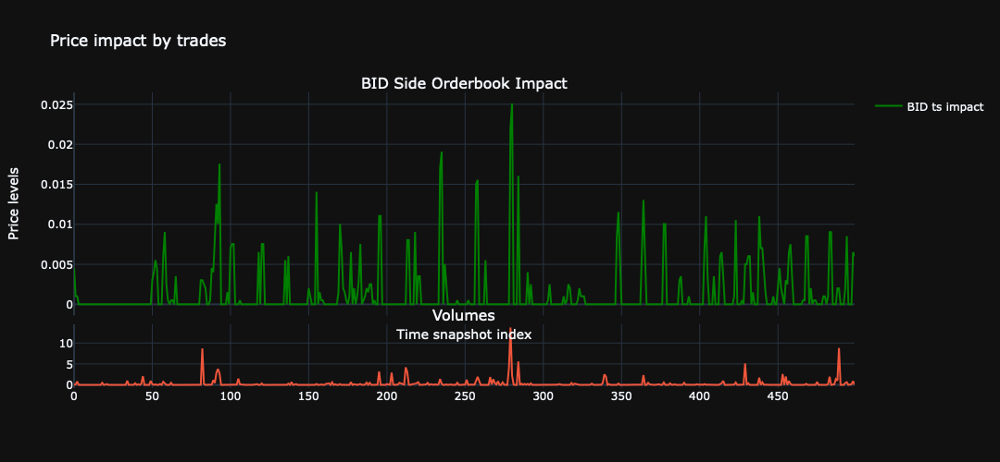

In [770]:
plot_price_impact(4000, 4500, df_bid_grouped, 'BID')

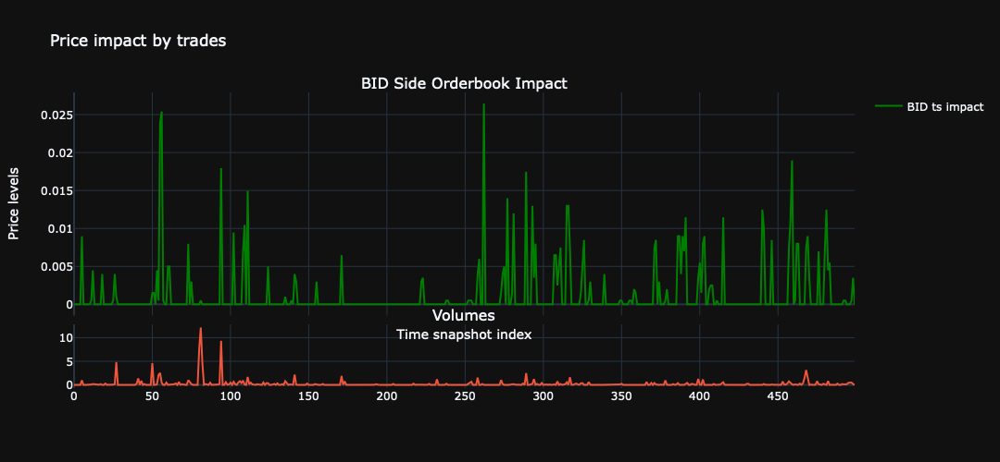

In [772]:
plot_price_impact(10000, 10500, df_bid_grouped, 'BID')

* **Volumes peaks correspond to impact peaks** 

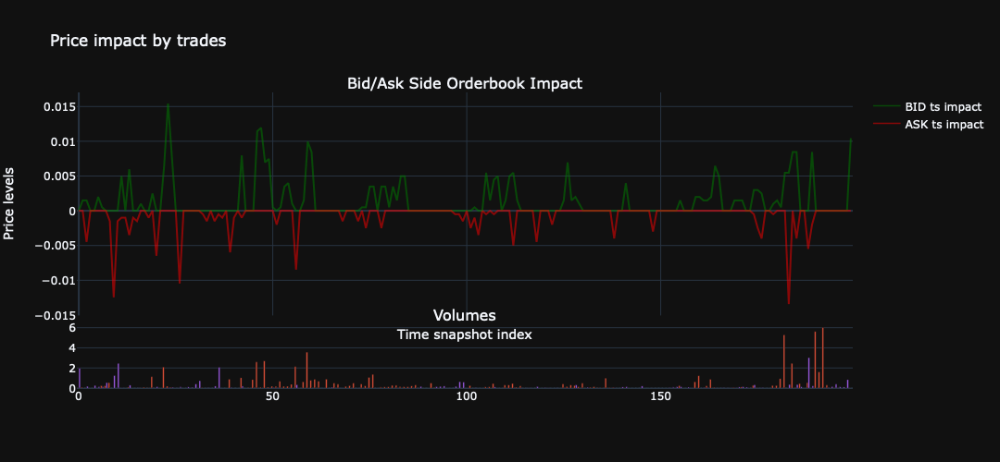

In [774]:
fig = go.Figure()

df_demo1=df_bid_grouped[14000:14200]
df_demo2=df_ask_grouped[14000:14200]

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
               vertical_spacing=0.03, subplot_titles=('Bid/Ask Side Orderbook Impact', 'Volumes'), 
               row_width=[0.2, 0.7])

fig.add_trace(go.Scatter(y=df_demo1['bid_impact'], marker_color='green', name='BID ts impact', opacity=0.5), row=1, col=1)


fig.add_trace(go.Bar(y=df_demo1['size'], showlegend=False,  name='BID volume'), row=2, col=1)

fig.add_trace(go.Scatter(y=df_demo2['ask_impact'], marker_color='red', name='ASK ts impact', opacity=0.5), row=1, col=1)


fig.add_trace(go.Bar(y=df_demo2['size'], showlegend=False,  name='ASK volume'), row=2, col=1)

fig.update_layout(
    title='Price impact by trades',
    xaxis_title="Time snapshot index",
    yaxis_title="Price levels",
    template='plotly_dark',
    height=500,
    showlegend=True,
)

fig.show()